In [2]:
from qiskit import BasicAer, Aer, IBMQ
from qiskit.aqua import QuantumInstance, aqua_globals
from qiskit.aqua.algorithms import VQE, ExactEigensolver
from qiskit.aqua.components.initial_states import Zero
from qiskit.aqua.components.optimizers import COBYLA, L_BFGS_B, SLSQP, SPSA
from qiskit.aqua.components.variational_forms import RY, RYRZ, SwapRZ
from qiskit.aqua.operators import WeightedPauliOperator, Z2Symmetries
from qiskit.chemistry import FermionicOperator
from qiskit.chemistry.drivers import PySCFDriver, UnitsType
from qiskit.chemistry.components.variational_forms import UCCSD
from qiskit.chemistry.components.initial_states import HartreeFock

from qiskit.providers.aer import QasmSimulator
from qiskit.providers.aer.noise import NoiseModel
from qiskit.providers.aer.noise.errors import QuantumError, ReadoutError
from qiskit.providers.aer.noise.errors import pauli_error
from qiskit.providers.aer.noise.errors import depolarizing_error
from qiskit.providers.aer.noise.errors import thermal_relaxation_error

from qiskit.providers.aer import noise
provider = IBMQ.load_account()

import numpy as np
import matplotlib.pyplot as plt
from functools import partial

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

### Now you can start choosing the components that make up your VQE algorithm!

#### 1. Optimizers
The most commonly used optimizers are `COBYLA`, `L_BFGS_B`, `SLSQP` and `SPSA`. 

#### 2. Qubit mapping
There are several different mappings for your qubit Hamiltonian, `parity`, `bravyi_kitaev`, `jordan_wigner`, which in some cases can allow you to further reduce the problem size.

#### 3. Initial state
There are different initial state that you can choose to start your simulation. Typically people choose from the zero state 
`init_state = Zero(qubitOp.num_qubits)` 
and the UCCSD initial state
`HartreeFock(qubitOp.num_qubits, num_spin_orbitals, num_particles, map_type, qubit_reduction)`

#### 4. Parameterized circuit
There are different choices you can make on the form of variational forms of your parameterized circuit.

`UCCSD_var_form = UCCSD(num_qubits, depth=depth, num_orbitals=num_spin_orbitals, num_particles=num_particles)`
    
`RY_var_form = RY(num_qubits, depth=depth)`
    
`RYRZ_var_form = RYRZ(num_qubits, depth=depth)`
    
`swaprz_var_form = SwapRZ(num_qubits, depth=depth)`

#### 5. Simulation backend
There are different simulation backends that you can use to perform your simulation

`backend = BasicAer.get_backend('statevector_simulator')`

`backend=Aer.get_backend('qasm_simulator')`

### Compare the convergence of different choices for building your VQE algorithm

Among the above choices, which combination do you think would out perform others and give you the lowest estimation of LiH ground state energy with the quickest convergence? Compare the results of different combinations against each other and against the classically computed exact solution at a fixed interatomic distance, for example `inter_dist=1.6`. 

To access the intermediate data during the optimization, you would need to utilize the `callback` option in the VQE function:

`def store_intermediate_result(eval_count, parameters, mean, std):
            counts.append(eval_count)
            values.append(mean)
            params.append(parameters)
            deviation.append(std)`
            
`algo = VQE(qubitOp, var_form, optimizer, callback=store_intermediate_result)`

`algo_result = algo.run(quantum_instance)`

An example of comparing the performance of different optimizers while using the RY variational ansatz could like the following:
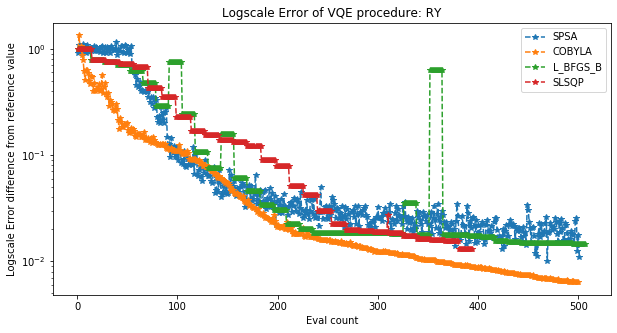
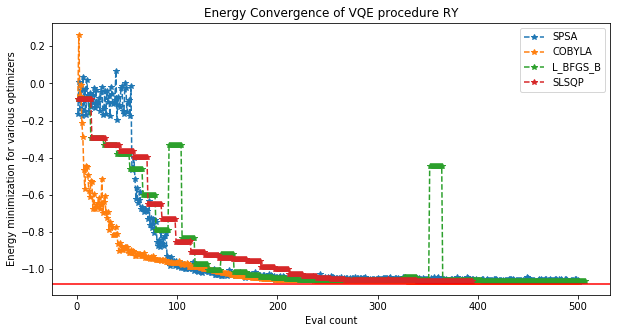

### Compute the ground state energy of LiH at various different interatomic distances
By changing the parameter `inter_dist`, you can use your VQE algorithm to calculate the ground state energy of LiH at various interatomic distances, and potentially produce a plot as you are seeing here. Note that the VQE results are very close to the exact results, and so the exact energy curve is hidden by the VQE curve.
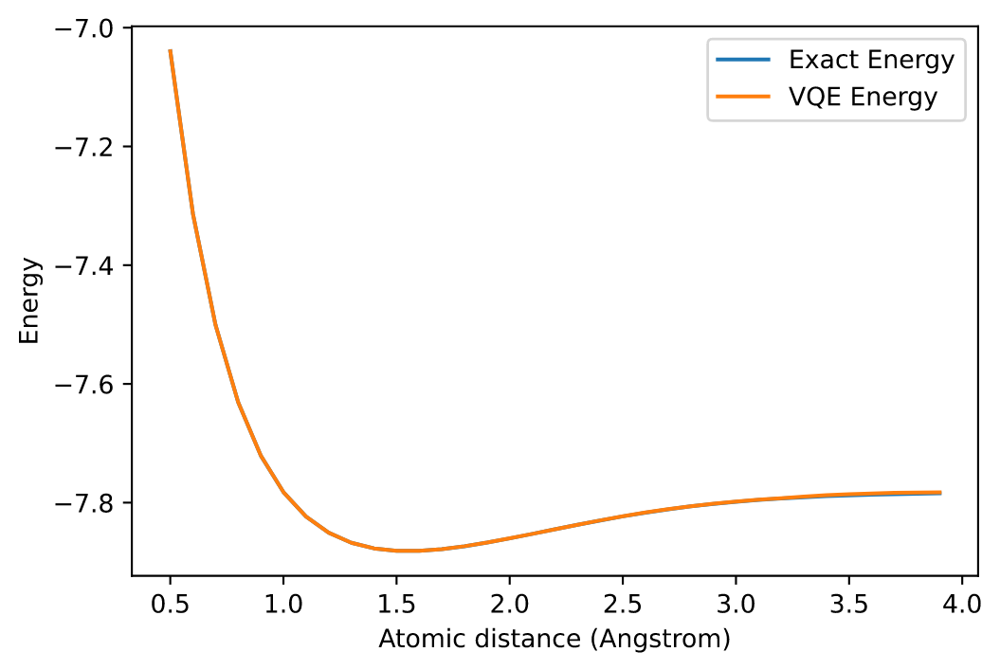

### How does your VQE algorithm perform in the presence of noise?
Trying importing the noise model and qubit coupling map of a real IBM quantum device into your simulation. You can use the imported noise model in your simulation by passing it into your quantum instance. You can also try enabling error mitigation in order to lower the effect of noise on your simulation results.

In [7]:
#Define our noise model based on the ibmq_essex chip
chip_name = 'ibmq_essex'
device = provider.get_backend(chip_name)
coupling_map = device.configuration().coupling_map
noise_model = noise.device.basic_device_noise_model(device.properties())
basis_gates = noise_model.basis_gates

An example of comparing the energy convergence of using SPSA and COBYLA with the ibmq_essex noise model could look like the following
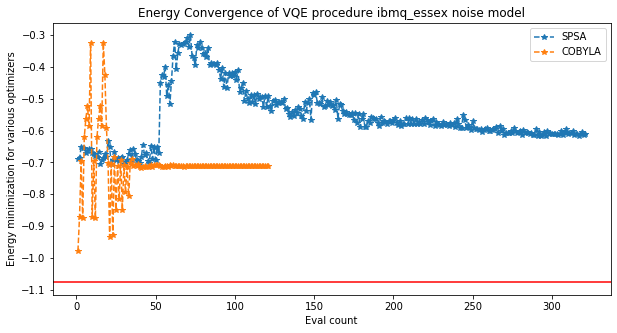

### Now given the choices you have made above, try writing your own VQE algorithm in Qiskit. You can find an example of using Qiskit to simuate molecules with VQE [here](https://qiskit.org/textbook/ch-applications/vqe-molecules.html).

In [7]:
# Classically solve for the lowest eigenvalue
# This is used just to compare how well you VQE approximation is performing
def exact_solver(qubitOp):
    ee = ExactEigensolver(qubitOp)
    result = ee.run()
    ref = result['energy']
    #print('Reference value: {}'.format(ref))
    return ref

In [8]:
# Define your function for computing the qubit operations of LiH
def compute_LiH_qubitOp(map_type, inter_dist, basis='sto3g'):
    
    # Specify details of our molecule
    driver = PySCFDriver(atom='Li .0 .0 .0; H .0 .0 ' + str(inter_dist), unit=UnitsType.ANGSTROM, charge=0, spin=0, basis=basis)

    # Compute relevant 1 and 2 body integrals.
    molecule = driver.run()
    h1 = molecule.one_body_integrals
    h2 = molecule.two_body_integrals
    nuclear_repulsion_energy = molecule.nuclear_repulsion_energy
    
    num_particles = molecule.num_alpha + molecule.num_beta
    num_spin_orbitals = molecule.num_orbitals * 2
    print("HF energy: {}".format(molecule.hf_energy - molecule.nuclear_repulsion_energy))
    print("# of electrons: {}".format(num_particles))
    print("# of spin orbitals: {}".format(num_spin_orbitals))

    # Please be aware that the idx here with respective to original idx
    freeze_list = [0]
    remove_list = [-3, -2] # negative number denotes the reverse order
    
    # Prepare full idx of freeze_list and remove_list
    # Convert all negative idx to positive
    remove_list = [x % molecule.num_orbitals for x in remove_list]
    freeze_list = [x % molecule.num_orbitals for x in freeze_list]
    
    # Update the idx in remove_list of the idx after frozen, since the idx of orbitals are changed after freezing
    remove_list = [x - len(freeze_list) for x in remove_list]
    remove_list += [x + molecule.num_orbitals - len(freeze_list)  for x in remove_list]
    freeze_list += [x + molecule.num_orbitals for x in freeze_list]

    # Prepare fermionic hamiltonian with orbital freezing and eliminating, and then map to qubit hamiltonian
    # and if PARITY mapping is selected, reduction qubits
    energy_shift = 0.0
    qubit_reduction = True if map_type == 'parity' else False

    ferOp = FermionicOperator(h1=h1, h2=h2)
    if len(freeze_list) > 0:
        ferOp, energy_shift = ferOp.fermion_mode_freezing(freeze_list)
        num_spin_orbitals -= len(freeze_list)
        num_particles -= len(freeze_list)
    if len(remove_list) > 0:
        ferOp = ferOp.fermion_mode_elimination(remove_list)
        num_spin_orbitals -= len(remove_list)

    qubitOp = ferOp.mapping(map_type=map_type)
    qubitOp = Z2Symmetries.two_qubit_reduction(qubitOp, num_particles) if qubit_reduction else qubitOp
    qubitOp.chop(10**-10)

    return qubitOp, num_spin_orbitals, num_particles, qubit_reduction

In [9]:
inter_dist=1.6
map_type='parity'
qubitOp, num_spin_orbitals, num_particles, qubit_reduction = compute_LiH_qubitOp(map_type, inter_dist)

HF energy: -8.854072040283645
# of electrons: 4
# of spin orbitals: 12


In [10]:
#after reduction
print("qubitOp=",qubitOp)
print("num_spin_orbitals=",num_spin_orbitals)
print("num_particles=",num_particles)
print("qubit_reduction",qubit_reduction)

qubitOp= Representation: paulis, qubits: 4, size: 100
num_spin_orbitals= 6
num_particles= 2
qubit_reduction True


In [28]:
depth=6

# Specify your initial state
init_state =  HartreeFock( num_spin_orbitals,num_particles, map_type, qubit_reduction)

# Select a state preparation ansatz
# Equivalently, choose a parameterization for our trial wave function.
#var_form_0= UCCSD(qubitOp.num_qubits, num_orbitals=num_spin_orbitals,depth=depth, num_particles=num_particles)
var_form_1= RYRZ(qubitOp.num_qubits, depth=depth)
var_form_2= RY(qubitOp.num_qubits, depth=depth)
var_form_3=SwapRZ(qubitOp.num_qubits, depth=depth)
var_form=[var_form_1,var_form_1,var_form_2,var_form_3]
# Choose where to run/simulate our circuit
quantum_instance = BasicAer.get_backend('statevector_simulator')

# Choose the classical optimizer
optimizer =COBYLA(maxiter=1000)

# Run your VQE instance
vqe = VQE(qubitOp, var_form[0], optimizer)

results = vqe.run(quantum_instance)

In [12]:
# Now compare the results of different compositions of your VQE algorithm!

In [13]:
#print(results)
#print("Parameters: {}".format(results.optimal_point))
print('The computed ground state energy is: {:.12f}'.format(results.eigenvalue.real))
print('Reference value:',exact_solver(qubitOp))

The computed ground state energy is: -1.069513763049
Reference value: -1.0770597457346924


In [14]:
def store_intermediate_result(eval_count, parameters, mean, std):
            counts.append(eval_count)
            values.append(mean)
            params.append(parameters)
            deviation.append(std)

In [15]:
counts=[]
values=[]
params=[]
deviation=[]
algo = VQE(qubitOp, var_form, optimizer,callback=store_intermediate_result)#VQE(qubitOp, var_form, optimizer, callback=store_intermediate_result)
algo_result = algo.run(quantum_instance)

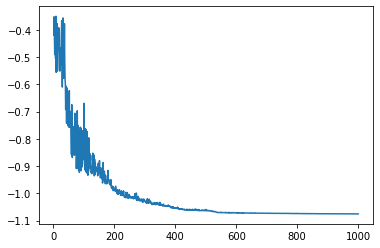

In [19]:

plt.plot(counts,values)

In [ ]:
Exact_energy=[]
VQE_energy=[]
inter_dists=[]
i_d=0.5
while(i_d<=4):
    inter_dist=i_d
    inter_dists.append(inter_dist)
    print(i_d)
    i_d=i_d+1
    qubitOp, num_spin_orbitals, num_particles, qubit_reduction = compute_LiH_qubitOp(map_type, inter_dist)
    vqe = VQE(qubitOp, var_form, optimizer)
    results = vqe.run(quantum_instance)
    VQE_energy.append(results.eigenvalue.real)
    Exact_energy.append(exact_solver(qubitOp))

0.5
HF energy: -10.203473360061938
# of electrons: 4
# of spin orbitals: 12


FAILURE: Can not get job id, Resubmit the qobj to get job id.Error: A child process terminated abruptly, the process pool is not usable anymore 
FAILURE: Can not get job id, Resubmit the qobj to get job id.Error: A child process terminated abruptly, the process pool is not usable anymore 
FAILURE: Can not get job id, Resubmit the qobj to get job id.Error: A child process terminated abruptly, the process pool is not usable anymore 
FAILURE: Can not get job id, Resubmit the qobj to get job id.Error: A child process terminated abruptly, the process pool is not usable anymore 
FAILURE: Can not get job id, Resubmit the qobj to get job id.Error: A child process terminated abruptly, the process pool is not usable anymore 
FAILURE: Can not get job id, Resubmit the qobj to get job id.Error: A child process terminated abruptly, the process pool is not usable anymore 
FAILURE: Can not get job id, Resubmit the qobj to get job id.Error: A child process terminated abruptly, the process pool is not u

In [ ]:
plt.plot(VQE_energy,inter_dists)

In [23]:
#Now with noise
#Define our noise model based on the ibmq_essex chip
chip_name = 'ibmq_essex'
device = provider.get_backend(chip_name)
coupling_map = device.configuration().coupling_map
noise_model = noise.device.basic_device_noise_model(device.properties())
basis_gates = noise_model.basis_gates

In [24]:

quantum_instance_noice = QuantumInstance(backend=backend, 
                                   shots=1000, 
                                   noise_model=noise_model, 
                                   coupling_map=coupling_map,
                                   #measurement_error_mitigation_cls=CompleteMeasFitter,
                                   cals_matrix_refresh_period=30)

AquaError: 'The noise model is not supported on the selected backend statevector_simulator (BasicAer) only certain backends, such as Aer qasm support noise.'

In [25]:
results = vqe.run(quantum_instance_noice)
print('The computed ground state energy is: {:.12f}'.format(results.eigenvalue.real))
print('Reference value:',exact_solver(qubitOp))

NameError: name 'quantum_instance_noice' is not defined

In [ ]:
import qiskit.tools.jupyter
%qiskit_version_table
%qiskit_copyright